# Análisis Exploratorio de Datos

### Importar librerias

In [35]:
import pandas as pd
import dask.dataframe as dd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt

### Leer datos

In [2]:
def parquet_to_df(route):
    
    df = dd.read_parquet(route)
    return df

In [25]:
route = 'processing_data_0001_dummie.parquet'

df = parquet_to_df(route)
df = df.compute()

In [26]:
df['month'] = df['date'].dt.month
df['day'] = df['date'].dt.day
df.head()

,merchant_id,_id,subsidiary,transaction_date,account_number,user_id,transaction_amount,transaction_type,date,month,day
16066,838a8fa992a4aa2fb5a0cf8b15b63755,4a101c7ee6f4f8f1fcdbd4bc044c59d8,f54e0b6b32831a6307361ed959903e76,2021-01-01 00:00:40,8fee49f3fedc5590551fcb57a2f58a3e,2fa852d1bd38bbbcf4afd629f4a7c51b,5.944,CREDITO,2021-01-01,1,1
341948,817d18cd3c31e40e9bff0566baae7758,47d6c9460c5c27d63d6e66d23e598695,6f19909d89f3178ea74b3cee1f20af13,2021-01-01 00:01:08,f75a7c37888408308e02fef9086046fe,516c209606ac9f7e870802c90bffbaf8,59.445,DEBITO,2021-01-01,1,1
1097759,817d18cd3c31e40e9bff0566baae7758,8c2df593436163e9cbff2fe3050f0ae1,c1b186a762110afc5d510517b04b6329,2021-01-01 00:01:13,a49b390b90de1454f966c604da9687d3,8c8b5512b0772dc891bef619ecd2acfb,47.556,DEBITO,2021-01-01,1,1
124971,838a8fa992a4aa2fb5a0cf8b15b63755,6ed538998f04c804c299dc9fbc4d6e90,dff70ce33784a932ce4a7efc81a43863,2021-01-01 00:01:17,666e5e749c3ae3dea220e023a51c88f4,d0a25a8f11f7228d912e6874a0544d41,5.944,CREDITO,2021-01-01,1,1
1401278,838a8fa992a4aa2fb5a0cf8b15b63755,8801042a2192cdb8d96074442e5d4e06,d4b31b123120a4eefd51ba95975f2ae4,2021-01-01 00:01:45,c039cca9581596ee863c3c812835bfff,6b6113f0dfead46eb7f0c21ecb78d567,5.944,DEBITO,2021-01-01,1,1


### Análisis descriptivo

Analizar datos es descubrir historias, es como una madeja de hilo que va desenrollandose a medida que se encuentran relaciones, patrones, causalidades. La historia que nos reune en este caso de estudio tiene como protagonista a  los registros que representan las transacciones. <br>

Empezare por revisar su comportamiento en el tiempo, el volumen de moneda que mueven y como este fluctua a traves del analisis de estadisticos descriptivos basicos (mediana, promedio). Es importante incluir la mediana, ya que los datos tienen presencia de muchos outliers o valores unicos en moneda( transaction_amount) por registro y el promedio no puede modelar por si solo de manera fidedigna este dato.

In [6]:
registros_per_date= df.groupby('date')['_id'].count().reset_index()
registros_per_date.rename(columns={'_id': 'total_transactions'}, inplace=True)

median_amount_per_date= df.groupby('date')['transaction_amount'].median().reset_index()
median_amount_per_date.rename(columns={'transaction_amount': 'median_transaction_amount'}, inplace=True)

mean_amount_per_date= df.groupby('date')['transaction_amount'].mean().reset_index()
mean_amount_per_date.rename(columns={'transaction_amount': 'mean_transaction_amount'}, inplace=True)

transactions_in_time = mean_amount_per_date.merge(median_amount_per_date, on='date').merge(registros_per_date, on='date')
transactions_in_time

,date,mean_transaction_amount,median_transaction_amount,total_transactions
0,2021-01-01,80.602337,9.511,18335
1,2021-01-02,122.091963,38.045,41255
2,2021-01-03,108.569752,23.778,37285
3,2021-01-04,144.377721,59.445,68152
4,2021-01-05,140.031303,59.445,67989
...,...,...,...,...
329,2021-11-26,216.335591,118.889,89187
330,2021-11-27,213.741771,118.889,81797
331,2021-11-28,185.466722,95.111,58363
332,2021-11-29,225.012669,118.889,86955


In [7]:
fig = go.Figure()

# Añadir la línea para 'registros_per_date' en el eje y derecho
fig.add_trace(go.Scatter(x=transactions_in_time['date'], y=transactions_in_time['total_transactions'],
                         mode='lines', name='Total transacciones por fecha', yaxis='y2'))

# Añadir la línea para 'mean_amount_per_date' en el eje y izquierdo
fig.add_trace(go.Scatter(x=transactions_in_time['date'], y=transactions_in_time['mean_transaction_amount'],
                         mode='lines', name='Promedio moneda por transaccion'))

# Añadir la línea para 'median_amount_per_date' en el eje y izquierdo
fig.add_trace(go.Scatter(x=transactions_in_time['date'], y=transactions_in_time['median_transaction_amount'],
                         mode='lines', name='Mediana moneda por transaccion'))

# Configurar los ejes
fig.update_layout(title='Comportamiento transaccional',
                  yaxis=dict(title='Promedio + Mediana moneda', titlefont=dict(color='red')),
                  yaxis2=dict(title='# Transacciones', titlefont=dict(color='blue'), overlaying='y', side='right'))

# Mostrar el gráfico
fig.show()

¡Wow! Cada que un grafico esta procesando me lleno de emocion ¡Se acerca un descubrimiento!. Veran, aca hay algo muy interesante:

*  Se percibe una variación bimensual en el volumen transaccional. 
*  El promedio y la mediana tienen un comportamiento atipico en los dos primeros meses respecto a los demas meses

Ahora voy a revisar el total de transacciones por mes y el volumen maximo y minimo de transacciones por dia que sucedio en ese mes. Con esto me hago un poco a la idea de los volumenes transaccionales diarios

In [55]:
# Calcular el total de transacciones por mes
total_transactions_month = df.groupby('month').size().reset_index(name='total_transactions_month')

transaction_at_day_per_month = df.groupby(['month', 'day']).size().reset_index(name='count')
# Encontrar el máximo valor de transacciones por día en cada mes
max_transaction_at_day_per_month = transaction_at_day_per_month.groupby('month')['count'].max().reset_index(name='max_transaction_at_day_per_month')
# Encontrar el minimo valor de transacciones por día en cada mes
min_transaction_at_day_per_month = transaction_at_day_per_month.groupby('month')['count'].min().reset_index(name='max_transaction_at_day_per_month')

# Paso 3: Combinar los resultados en un nuevo DataFrame llamado rate_transaction_month
rate_transaction_month = pd.merge(total_transactions_month, max_transaction_at_day_per_month, on='month')
rate_transaction_month = pd.merge(rate_transaction_month, min_transaction_at_day_per_month, on='month')

rate_transaction_month = rate_transaction_month.rename(columns={
                                                                'max_transaction_at_day_per_month_x': 'max_transactions_day',
                                                                'max_transaction_at_day_per_month_y': 'min_transactions_day'
                                                                })


In [59]:
fig = go.Figure()

# Agregar las líneas al gráfico
fig.add_trace(go.Scatter(x=rate_transaction_month['month'], y=rate_transaction_month['total_transactions_month'], mode='lines+markers', name='total transacciones por mes'))
fig.add_trace(go.Scatter(x=rate_transaction_month['month'], y=rate_transaction_month['max_transactions_day'], mode='lines+markers', name='max transacciones por dia en el mes'))
fig.add_trace(go.Scatter(x=rate_transaction_month['month'], y=rate_transaction_month['min_transactions_day'], mode='lines+markers', name='min transacciones por dia en el mes'))

# Configurar el diseño del gráfico
fig.update_layout(title='Analisis de volumen transaccional por mes',
                  xaxis_title='mes',
                  yaxis_title='# transacciones')

# Mostrar el gráfico
fig.show()


Una relacion fundamental que esta relacionada desde la transaccion es el ```transaction_amount```, es decir, la moneda ficticia objeto de cada transaccion. Esta tiene un papel importante porque nos va a permitir identificar las diferencias transaccionales de nuestro problema: la mala practica transaccional.Lo primero es revisar la distribución de datos usando un boxplot

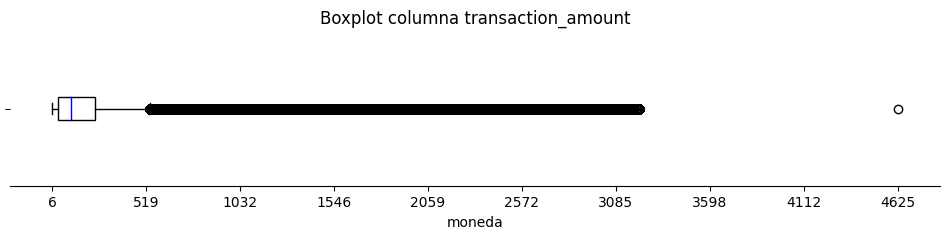

In [8]:
fig, ax = plt.subplots(figsize=(12, 2))
bp = plt.boxplot(df.transaction_amount, vert=False, patch_artist=True)

# Personalizar el color del boxplot y de la línea de la mediana
for box in bp['boxes']:
    box.set(facecolor='white')

for median in bp['medians']:
    median.set(color='blue')  

# Quitar el eje y
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.set_yticklabels([])

# Ajustar el espaciado de los ticks  en el eje x para mostrar más números
n_ticks = 10  
x_min, x_max = min(df.transaction_amount), max(df.transaction_amount)
step_size = (x_max - x_min) / (n_ticks - 1)
ticks = [x_min + i * step_size for i in range(n_ticks)]
ax.set_xticks(ticks)

plt.title('Boxplot columna transaction_amount')
plt.xlabel('moneda')
plt.show()

Ahora, quiero revisar quienes y cuantos son los protagonistas del , para esto voy a ignorar las columnas que describen todo el dataframe: _id, transaction_date y aplico una funcion unique a las demas columnas para conocer la cantidad de datos unicos que tienen. 

In [12]:
columns_to_count_unique = ['merchant_id', 'subsidiary', 'account_number', 'user_id', 'transaction_amount', 'transaction_type', 'date']

df_columns_to_count_unique = df.loc[:, columns_to_count_unique]
unique_values = df_columns_to_count_unique.nunique()

# Crear el gráfico de barras horizontal utilizando Plotly Express
fig = px.bar(unique_values, orientation='h', text_auto='.1s')
fig.update_traces(textfont_size=10, textangle=0, textposition="outside", cliponaxis=False)

# Personalizar el diseño del gráfico
fig.update_layout(title='Número de valores únicos por columna',
                  xaxis=dict(title='volumen valores unicos'),
                  yaxis=dict(title='Columna'),
                  showlegend=False)

# Mostrar el gráfico en pantalla
fig.show()

Como los valores unicos para user_id y account_number son muy cercanos es posible que estos datos esten relacionados. Es decir, el account_number pertenezca al user_id. Voy a probarlo y a inferir el modelado de la informacion para la interpretación

### Hipotesis de analisis

#### **Uno** <br>
```user_id``` y ```account_number```  estan relacionados. Un user_id es el dueño del account_number

* Numero de account_number por user_id

In [69]:
# Aplicar groupby para contar el número de account_number por user_id
account_per_user = df.groupby('user_id')['account_number'].nunique().reset_index()

# Cambiar nombre de columna count por numero_account_numbers (opcional)
account_per_user.rename(columns={'account_number': 'nums_account'}, inplace=True)
account_per_user = account_per_user.sort_values(by='nums_account', ascending=False)


In [68]:
fig = px.histogram(account_per_user, x="nums_account", log_y=True, text_auto='.1s')
fig.update_traces(textfont_size=10, textangle=0, textposition="inside", cliponaxis=False)

fig.update_layout(
    xaxis_title="# account_number",
    yaxis_title="Conteo (log)",
    title="Hist account_number por user_id",
)
fig.show()

**Inferencia:** No es coherente que un user_id en un timeline de 334 dias solo se relaciones con max 43 cuentas bajo el supuesto que el usuario es quien origina la transacción y el account_number el destino

In [73]:
# Ingreso el user_id que esta asociado al numero maximo de cuentas para explorar sus transacciones en el tiempo a esas cuenta
user_max_transactions = df[df['user_id'] == '8c292781ac3e591312d7fc5b767687ca']


# Con el filtro anterior agrupo por numero de cuenta y date contando los registros o transacciones 
umt_account_date_id = user_max_transactions.groupby(['date', 'account_number'])['_id'].count().reset_index()
umt_account_date_id = umt_account_date_id.sort_values(by="date", ascending= True)

user_id que se pueden probar en el codigo anterior para verificar la hipotesis, voy a dejar aca unos cuantos pero con todos tenemos el mismo comportamiento: 

- 6ba67792fbc4e375fa69ed6df0e44854
- 328550eea11d2441ab258a1f07581dc8
- a9fbdb2d32424dbac15edc0b17c12e23
- 62e1cb0b55d1d7b577292916528ef6d8
- 8c292781ac3e591312d7fc5b767687ca

In [74]:
# Crear el gráfico de líneas con Plotly Express
fig = px.line(umt_account_date_id, x='date', y='_id', color='account_number', markers=True)
fig.show()

**Inferencia:** Analizando los usuarios relacionados con > 1 cuenta pude identificar que el account_number no se utilizan en los mismos periodos de tiempo. Es probable que los usuarios que tienen muchas cuentas abran y cierren los productos, es decir, cambian de productos ( account_number) en el tiempo

* Numero de user_id por account_number

In [114]:
user_per_account = df.groupby('account_number')['user_id'].nunique().reset_index()
user_per_account.rename(columns={'user_id': 'nums_users'}, inplace=True)
user_per_account = user_per_account.sort_values(by='nums_users', ascending=False)

,account_number,nums_users
3084186,feb367d16257964717579b48eceda14d,2
2202080,b5ce8deb00aee0c249582fafee774f06,2
2451385,ca621319e02dd169fc512f0e63e7d98b,2
2430807,c8b46e2f9979a195c829f6832826e095,2
2089695,ac8253642eda540ef5a4d2ea45866082,2
...,...,...
1033241,55382102467da5cf78ad05fb26634bd8,1
1033242,553821f20615ce763caa14dea94c2a05,1
1033243,553823913879a91ae942b87259d9f0a0,1
1033244,5538308b17b89ed5543a1488a0ab9c25,1


**Inferencia:** No es coherente que un account_number solo se relacione maximo con dos usuarios a nivel transaccional dado el volumen de registros. Es decir, que el flujo moneda vaya en direccion de un account_number a un user_id o viceversa

In [115]:
counts_user_per_account =  user_per_account.nums_users.value_counts()
df_user_per_account = pd.DataFrame(counts_user_per_account).reset_index()

total_users = df_user_per_account['count'].sum()
df_user_per_account['percentage'] = (df_user_per_account['count'] / total_users) * 100

df_user_per_account

,nums_users,count,percentage
0,1,3099691,99.999355
1,2,20,0.000645


In [116]:
# Ingreso el account_id que esta asociado al numero maximo de usuarios para explorar sus transacciones en el tiempo a esas cuenta
account_number_max_transactions= df[df['account_number'] == 'c8b46e2f9979a195c829f6832826e095']

account_id que se pueden probar en el codigo anterior para verificar la hipotesis, voy a dejar aca unos cuantos pero con todos tenemos el mismo comportamiento: 

- feb367d16257964717579b48eceda14d
- b5ce8deb00aee0c249582fafee774f06	
- ca621319e02dd169fc512f0e63e7d98b	
- c8b46e2f9979a195c829f6832826e095	
- ac8253642eda540ef5a4d2ea45866082	

In [111]:
# Aplicar groupby para contar el número de transacciones por fecha
amt_user_date_id = account_number_max_transactions.groupby(['date', 'user_id'])['_id'].count().reset_index()
amt_user_date_id = amt_user_date_id.sort_values(by="date", ascending= True)

In [112]:
fig = px.line(amt_user_date_id, x='date', y='_id', color='user_id', markers=True)
fig.show()

**Inferencia:** Menos del 1% de los user_id estan relacionados con >1 cuenta. Podemos identificar que la relacion del user_id con el account_number sucede en periodos de tiempo diferentes, es probable que el user_id se haya registrado con otra entidad en el sistema. Por ejemplo: cambio de tipo de identificacion, entre otras.

#### **Dos**  
```merchant_id``` y ```subsidiary```  estan relacionados. Cada merchant_id tiene un subsidiary o merchand_id es la categoria padre de subsidiary. Solo tenemos en los datos 3 merchant_id unicos y +200 subsidiary

In [118]:
# Aplicar groupby para contar el número de _id por subsidiary y merchant_id
subsidiary_per_merchant_id= df.groupby('subsidiary')['merchant_id'].nunique().reset_index()

subsidiary_per_merchant_id.rename(columns={'merchant_id': 'nums_merchant_id'}, inplace=True)
subsidiary_per_merchant_id = subsidiary_per_merchant_id.sort_values(by='nums_merchant_id', ascending=False)

subsidiary_per_merchant_id

,subsidiary,nums_merchant_id
0,00015fd77a0f4d869bea31bb7244e375,1
11212,aa06d89a12afcb820d56d9e221a12ad3,1
11214,aa10dfdccf65363b346fae4d67078fcb,1
11215,aa1598dcd456778746e64e76e2cc0b5c,1
11216,aa1d49877f7d77d1ed0f22619c21c1c6,1
...,...,...
5616,54f8eb563d79cc20846cf8cd49d21a40,1
5617,54ff44dc1d4d9f9ffa1a103324db2d38,1
5618,55009672b2ba96dcba7b2a052a56564f,1
5619,5501e7a4c3a89a6f3cbe345251749f43,1


#### **Tres**
El flujo de moneda sale de un ```account_number``` hacia un ```subsidiary```  

In [117]:
subsidiary_per_account= df.groupby('account_number')['subsidiary'].nunique().reset_index()

# Cambiar nombre de columna count por numero_account_numbers (opcional)
subsidiary_per_account.rename(columns={'subsidiary': 'nums_subsidiary'}, inplace=True)
subsidiary_per_account = subsidiary_per_account.sort_values(by='nums_subsidiary', ascending=False)

subsidiary_per_account

,account_number,nums_subsidiary
361395,1dcf4a1f1d7ca94a77ca6efcc68c1c62,254
2071045,aafc1c9caf601aa4d27b0b5397b73243,211
2079987,abb90fe99e08a3eabbe8a85a24bca7e8,194
1175069,60e55686ae78d19d09fa81e3f49857f9,184
1243930,669223a6679cd07a026f97fe4b197651,167
...,...,...
2087471,ac55e0e6802044df6828f57c4f55e0aa,1
2087470,ac55df6235079f3ccc6f039c70042a21,1
2087468,ac55d4838c92cfb59a4cbe1250aa4248,1
2087467,ac55d08b6efa79e529df87ce297b19e1,1


**Inferencia:** Un account_number se relaciona hasta con 254 subsidiarys, es decir envia dinero hasta a 254 destino diferentes en el timeframe. Voy a recordar que hay 3'099.711 account_number unicas 

In [125]:
# Creo una lista con los account_number que solo se relacionan con 1 subsidiary para filtrar el set de datos principal y hacer analisis
filter_nums_subsidiary_1 = subsidiary_per_account[subsidiary_per_account['nums_subsidiary'] == 1]
list_account_number_subs1 = list(filter_nums_subsidiary_1['account_number'])

account_subsidiary_1_filtered= df[df['account_number'].isin(list_account_number_subs1)] 
account_subsidiary_1_filtered.count()

merchant_id           2214544
_id                   2214544
subsidiary            2214544
transaction_date      2214544
account_number        2214544
user_id               2214544
transaction_amount    2214544
transaction_type      2214544
date                  2214544
month                 2214544
day                   2214544
dtype: int64

**Inferencia:** De esas cuentas que se relacionan solo con un subsidiary  tenemos 2'214.546 transacciones. Es decir, el 10% de las cuentas solo han enviado transacciones a un subsidiary unico

In [129]:
subsidiary_counts = subsidiary_per_account.nums_subsidiary.value_counts()

subsidiary_accounts_rel = pd.DataFrame(subsidiary_counts).reset_index()
subsidiary_accounts_rel = subsidiary_accounts_rel.sort_values(by='nums_subsidiary', ascending= True)
subsidiary_accounts_rel.head(10)

,nums_subsidiary,count
0,1,1309531
1,2,594093
2,3,335667
3,4,213703
4,5,145809
5,6,104187
6,7,77862
7,8,59692
8,9,46297
9,10,37445


**Inferencia:** De los 3'099.711 de account_number tenemos 1'309.531 que le han hecho transferencias a un solo subsidiary, es decir, el 42% de las cuentas solo se relacionan con un subsidiary.

In [130]:
# df_filtrado son las transacciones de las account_number que se relacionan solo con un subsidiary
group_account1subs_number = account_subsidiary_1_filtered.groupby('account_number')['_id'].count().reset_index()
group_account1subs_number = group_account1subs_number.sort_values(by='_id', ascending= False)
group_account1subs_number.head(10)

,account_number,_id
177973,22ae1905e262fc5b1a5776b91de24f7c,975
35914,0701dc85b35f9a99c09d99fdba5b6802,950
896443,af2b49291e1321b66e7bce28c7a63c58,817
1281737,fa8d1ce714e7b42c03c3c0d990ca99b3,800
395751,4d32282feb906bda832ab00660978aec,800
1117602,da73365d56faf269e85798c390a2a39a,798
284153,3765071dac15544f7209076da1dea039,773
694227,877177869e54039082c7d6eaa17e2ad0,770
333379,410b5e527aef1257726fe7dbfc77f1e0,689
715020,8b7e5170d415e44659078242640939d8,600


In [132]:
count_account_1_subsidiary = group_account1subs_number._id.value_counts()
count_accountsubsidiary = pd.DataFrame(count_account_1_subsidiary).reset_index()
count_accountsubsidiary.head()

,_id,count
0,1,987198
1,2,181997
2,3,61760
3,4,28468
4,5,15237


**Inferencia:** De 1'309.531 account numbers, 987.197 solo han hecho una transaccion. El 24% de las cuentas que solo se relaciona con 1 subsidiary tiene mas de 1 transaccion; este 24% de cuentas es el que nos interesa porque son sospechosos del fraccionamiento transaccional

In [133]:
#Se agruparon por fecha las transacciones que ha hecho cada account_number al unico subsidiary con el que esta relacionado
group_account1subsDate_number = account_subsidiary_1_filtered.groupby(['account_number','date'])['_id'].count().reset_index()
group_account1subsDate_number = group_account1subsDate_number.sort_values(by='_id', ascending= False)

#### **Tres.1**
Voy a hacer un analisis sobre el grupo border, es decir, el 24% de las cuentas mencionadas lineas arriba.

De los account_number que solo se relaciona con un subsidiary tomamos el que mas transacciones tenia (945) y analizamos su comportamiento en el tiempo. 
Encontramos que hace muchas transacciones por dia y solo en el primer trimestre del año.

In [134]:
filter_group_account1subsDate_number = group_account1subsDate_number[group_account1subsDate_number['account_number'] == '22ae1905e262fc5b1a5776b91de24f7c']

De los account_number que solo se relacionan con un subsidiary tomare como un ```comportamiento de interes``` para analizar los que tuvieran mas de 10 transacciones en un mismo dia y lo graficare 

In [140]:
filter_group_account1subsDate_ids = group_account1subsDate_number[group_account1subsDate_number['_id'] > 8]
filter_group_account1subsDate_ids = filter_group_account1subsDate_ids.sort_values(by=['date'], ascending = False)
filter_group_account1subsDate_ids

,account_number,date,_id
1807347,ea81df2411c2832b0b9af063f2e968ce,2021-11-18,10
1260359,a383dcd94e3808f66c17992dbddbcef0,2021-11-18,9
783648,659b82c2fe3a1d8c48e7d60d05771ab8,2021-11-11,15
805328,686c5d00f66c2ea7411da1114898c25d,2021-11-08,10
854332,6eb9a3adfedb9436e8ced6a6e825c7df,2021-11-05,9
...,...,...,...
1076005,8b7e5170d415e44659078242640939d8,2021-01-03,125
1454752,bce567807f3ef8bd33e1da570303d122,2021-01-03,98
502073,410b5e527aef1257726fe7dbfc77f1e0,2021-01-02,89
1076004,8b7e5170d415e44659078242640939d8,2021-01-02,116


In [141]:
fig = px.line(filter_group_account1subsDate_ids, x='date', y='_id', color='account_number', markers=True)
fig.show()

**Inferencia:** La mayoria de account numbers que solo se relacionan con un subsidiary y tienen mas de 10 transacciones diarias solo mueven el dinero en el primer trimestre del año. Este grafico se relaciona mucho con el grafico incial donde vemos que para el primer bimestre del año la mediana y promedio del transaction_amount estan muy reducidas pero la cantidad de transacciones son muchas, esto es un comportamiento que podriamos clasificar como mala practica transaccional

### **Conclusión**

Este EDA me permitio garantizar una interpretación correcta de la data para modelar el flujo de moneda y poder construir el analisis para la trasnformacion de los datos en features que pueda entregar a un modelo. A continuacíon les presento el evento que modela cada registro entregado en el set de datos

![Flujo de moneda](graficos\flujo_moneda_grafico.png)

Adicionalmente los siguientes insights:

* El primer bimestre del año tiene un comportamiento transaccional que difiere de la normalidad presentada en el año. Tenemos el mayor numero de transacciones por dia y los menores valores para la mediana y el promedio de moneda por transaccion. Esta relacion entre variables son un fuerte indicativo del fraccionamiento transaccional
* Revisando la data en escala mensual, el mayor volumen transaccional se presenta en los ultimos meses. Hay una disminucion en en el segundo bimestre, pero el comportamiento se puede describir en una funcion lineal. Los rangos de minimos y maximos transaccionales por dia en cada mes se mantienen entre 18335 y 100215 transacciones por dia en los limites inferior y superior respectivamente. 
* El fraccionamiento transaccional no está influenciado por el tipo de transacción (crédito o débito) porque es independiente de la frecuencia y la cantidad de transacciones realizadas. Ademas una cuenta puede estar relacionada a credito y debito. 
* Solo el 24% de las cuentas han tenido flujo transaccional con un unico subsidiary y tienen > 10 dias transacciones por dia. Esto es un comportamiento atipico que debe revisarse


### Analisis del flujo de moneda

¿Cuantos flujos de moneda unicos tenemos en nuestro set de datos?

In [9]:
money_flow = df.groupby(['account_number', 'subsidiary']).size().reset_index(name='total_transactions')
money_flow = money_flow.sort_values(by='total_transactions', ascending = False)
money_flow

,account_number,subsidiary,total_transactions
936713,171228ac3ecfa6c797a2ac382f22fc93,f54e0b6b32831a6307361ed959903e76,2297
1977863,3094e023b7a40245397e116bddbe45e8,f54e0b6b32831a6307361ed959903e76,2281
9969343,f53495dc604acd80a66c44448467cf32,f54e0b6b32831a6307361ed959903e76,1801
7634633,bbd2d9cbfd4a10fc3963c4094554315d,f54e0b6b32831a6307361ed959903e76,1785
7612165,bb43344022157cba434a58a212ed053f,f54e0b6b32831a6307361ed959903e76,1607
...,...,...,...
4151246,66036bd971f0f4722d1da52d8d7cac9d,f041d25923bedffbe5ec659e09eae9ee,1
4151243,66036bce38553ef360c0dbd04541c772,7a2f3407dd450c2c8d156d89338ebfaf,1
4151239,66036bce38553ef360c0dbd04541c772,038d2c1f0d16c26cba891e98bb044065,1
4151235,6603531091d716e8ebade85e71486b13,60fc43b614afbea86934d9f206cf9d13,1


Tenemos 10'404.112 millones de flujos de moneda como objeto de clasificación de las malas practicas transaccionales

¿Cuanto es el transaction_amount por transaccion diariamente? 

In [33]:
# Paso 1: Obtener los valores únicos de la columna 'date' y ordenar de manera ascendente
unique_dates = sorted(df['date'].unique())

# Paso 2: Crear los cinco rangos
ranges = [(i, i + 100) for i in range(0, 1601, 100)]

# Paso 3: Contar el número de registros en cada rango para cada fecha
result_data = []
for date in unique_dates:
    date_df = df[df['date'] == date]
    date_counts = [((start, end), ((date_df['transaction_amount'] >= start) & (date_df['transaction_amount'] <= end)).sum()) for start, end in ranges]
    date_counts = [count for _, count in date_counts]  # Eliminar las tuplas y quedarse solo con los conteos
    result_data.append([date] + date_counts)

# Crear el DataFrame final
columns = ['date'] + [f'{start}-{end}' for start, end in ranges]
result_df = pd.DataFrame(result_data, columns=columns)


In [34]:
# Transponer el DataFrame para que las fechas estén en el eje x y los rangos en el eje y
transposed_df = result_df.set_index('date').T.reset_index()

# Crear el heatmap con Plotly
fig = go.Figure(data=go.Heatmap(
    z=transposed_df.iloc[:, 1:].values,
    x=transposed_df.columns[1:],
    y=transposed_df['index'],
    colorscale='plasma', 
))

# Configuración del diseño del heatmap
fig.update_layout(
    title='Heatmap de conteo de transacciones por rango y fecha',
    xaxis_title='fecha',
    yaxis_title='moneda', height=800,
)

# Mostrar el heatmap
fig.show()

Este heatmap permite identificar los rangos transaccionales normales en terminos de volumen de moneda. Podemos inferir que usualmente los usuarios trasnfieren un volumen de moneda entre 0 y 100 por cada transacción.

Ademas podemos confirmar que en el primer bimestre del año tenemos muchas transacciones de valores muy pequeños.